### Question
* Is there any relationship between average position of edit vs. the accuracy of Brainbench item, hence manifesting position bias (to early tokens).

#### Motivation
* We saw reversed trained bayes model showed higher Brainbench acc as well as previously the backward trained models (though not significant). While previous models better acc could be due to tokenization resulting in more neuro tokens, the bayes series only differ in token order. 
* So one guess is due to position bias to early tokens, the reversed Brainbench had the results portion processed "better".
* Of course, one could argue against the idea because the original and altered versions are both processed "better" in reversed so whether that translates to better acc does not seem to be guaranteed.

In [177]:
import numpy as np
import pandas as pd
import transformers
import torch
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats
import statsmodels.api as sm

from utils import data_utils
from utils import model_utils
from utils import general_utils

### Toy example preparing data parsing
* For a combined brainbench abstract, we need to parse out the indices of each choice tokens (in between [[x, y]]) where the indices are wrt separate (original and altered) abstracts.
* Below parsing approach iteratively looks for [[x, y]], obtain the starting token index, replace [[x, y]] with separate x and y, and get corresponding x and y's indices.

* gpt2 tokenizer adds space to YYY in case where YYY is beginning but not the first beginning "XXX. YYY"

In [93]:
from transformers import GPT2Tokenizer
import re

pattern_start = r'^\[\[(.*?),\s*(.*?)\]\]'
combined_abstract = "[[anterior, posterior]] The anterior brain connects to cortex [[anterior, posterior]]. An example..."
placeholders_start = list(re.finditer(pattern_start, combined_abstract))
print(placeholders_start)

# Initialize a tokenizer (e.g., gpt2)
tokenizer = GPT2Tokenizer.from_pretrained("gpt2")
print(tokenizer.tokenize(combined_abstract))
print(tokenizer.tokenize("The anterior brain connects to cortex anterior, posterior, anteriorposterior"))

[<re.Match object; span=(0, 23), match='[[anterior, posterior]]'>]
['[[', 'an', 'terior', ',', 'Ġposterior', ']]', 'ĠThe', 'Ġanterior', 'Ġbrain', 'Ġconnects', 'Ġto', 'Ġcortex', 'Ġ[[', 'an', 'terior', ',', 'Ġposterior', ']', '].', 'ĠAn', 'Ġexample', '...']
['The', 'Ġanterior', 'Ġbrain', 'Ġconnects', 'Ġto', 'Ġcortex', 'Ġanterior', ',', 'Ġposterior', ',', 'Ġanterior', 'p', 'oster', 'ior']


In [ ]:
from transformers import GPT2Tokenizer
import re

# Initialize a tokenizer (e.g., gpt2)
tokenizer = GPT2Tokenizer.from_pretrained("gpt2")

In [110]:
def get_all_changes_indices(abstract_index, combined_abstract, tokenizer):
    """
    For a given combined_abstract, with [[x, y]] in the text, locate the indices of tokens of x and y,
    wrt their positions in the parsed out original and altered abstracts.

    The search algo works roughly as follows:
        1. Iteratively search for the next [[x, y]] in the original and altered texts.
        2. For each match, find the token positions of x and y in the original and altered texts.
        3. Replace [[x, y]] with the tokens of x and y in the original and altered texts.
        4. Store the indices of x and y in the result dictionary.
    
    Args:
        abstract_index (int): Index of the current abstract.
        combined_abstract (str): The full original text with placeholders.
        tokenizer: Tokenizer to use for tokenizing the text.

    Returns:
        result (dict): A dictionary containing the indices of x and y in the original and altered texts.
    """
    # Tokenize the full original text
    tokens = tokenizer.tokenize(combined_abstract)

    # Regex patterns:
    # 1. ^\[\[(.*?),\s*(.*?)\]\] - Matches [[x, y]] at the start of the string (beginning of a sentence)
    # 2. \s\[\[(.*?),\s*(.*?)\]\] - Matches " [[x, y]]" with a leading space elsewhere
    pattern_start = r'^\[\[(.*?),\s*(.*?)\]\]'  # Start of sentence
    pattern_space = r'\s\[\[(.*?),\s*(.*?)\]\]'  # With leading space

    # Function to find indices of a word at a specific token position
    def find_word_indices_at_position(abstract_tokens, word_tokens, expected_position):
        word_len = len(word_tokens)
        if abstract_tokens[expected_position:expected_position + word_len] == word_tokens:
            return list(range(expected_position, expected_position + word_len))
        return None

    # Base texts for original and altered (start as same)
    base_text_original = combined_abstract
    base_text_altered = combined_abstract

    # Base token lists
    base_tokens_original = tokens.copy()
    base_tokens_altered = tokens.copy()

    i = 0
    while True:
        print(f"\nMatching iter {i}")
        # Get the current [[x, y]] matches in the original and altered texts
        match_original_start = re.search(pattern_start, base_text_original)
        match_original_space = re.search(pattern_space, base_text_original)
        match_altered_start = re.search(pattern_start, base_text_altered)
        match_altered_space = re.search(pattern_space, base_text_altered)

        # Combine and sort matches for original and altered.
        matches_original = []
        if match_original_start:
            matches_original.append(match_original_start)
        if match_original_space:
            matches_original.append(match_original_space)
        matches_original.sort(key=lambda m: m.start())
        print(f"matches_original: {matches_original}")

        matches_altered = []
        if match_altered_start:
            matches_altered.append(match_altered_start)
        if match_altered_space:
            matches_altered.append(match_altered_space)
        matches_altered.sort(key=lambda m: m.start())
        print(f"matches_altered: {matches_altered}")

        if not matches_original and not matches_altered:
            print("No more matches found or left.")
            # Record the final length of the original and altered tokens
            result[abstract_index]["original"]["length"] = len(abstract_tokens_original)
            result[abstract_index]["altered"]["length"] = len(abstract_tokens_altered)
            break

        # Original and altered should have the same number of matches
        assert len(matches_original) == len(matches_altered), \
            "Mismatch in number of matches between original and altered texts."

        for match_idx in range(len(matches_original)):
            match_original = matches_original[match_idx]
            match_altered = matches_altered[match_idx]

            # Get the index of `_[[`
            char_index_original = match_original.start()
            char_index_altered = match_altered.start()

            x, y = match_original.groups()
            assert match_original.group(0) == match_altered.group(0), "Mismatch text between original and altered."
            print(f"\nmatch_idx: {match_idx}, match: [{match_original.group(0)}]")
            print(f"Processing replacement: x=[{x}] and y=[{y}] at char index original: [{char_index_original}]")
            print(f"Processing replacement: x=[{x}] and y=[{y}] at char index altered: [{char_index_altered}]")

            # Find the begin token position of _[[x, y]]
            tokens_before_original = tokenizer.tokenize(base_text_original[:char_index_original])
            token_begin_position_original = len(tokens_before_original)  # Where _[[x, y]] starts in token space
            tokens_before_altered = tokenizer.tokenize(base_text_altered[:char_index_altered])
            token_begin_position_altered = len(tokens_before_altered)  # Where _[[x, y]] starts in token space
            print(f"tokens_before_original: {tokens_before_original}, token_begin_position_original: [{token_begin_position_original}]")
            print(f"tokens_before_altered: {tokens_before_altered}, token_begin_position_altered: [{token_begin_position_altered}]")

            # Find the end token position of _[[x, y]]
            sq_bracket_string = match_original.group(0)
            sq_bracket_tokens = tokenizer.tokenize(sq_bracket_string)
            token_end_position_original = token_begin_position_original + len(sq_bracket_tokens) - 1
            token_end_position_altered = token_begin_position_altered + len(sq_bracket_tokens) - 1

            # Replace the [[x, y]] with tokens of x and y
            x_tokens = tokenizer.tokenize(" " + x)
            y_tokens = tokenizer.tokenize(" " + y)
            print(f"x_tokens: {x_tokens}")
            print(f"y_tokens: {y_tokens}")
            abstract_tokens_original = base_tokens_original[:token_begin_position_original] + x_tokens + base_tokens_original[token_end_position_original + 1:]
            abstract_tokens_altered = base_tokens_altered[:token_begin_position_altered] + y_tokens + base_tokens_altered[token_end_position_altered + 1:]
            
            # Find indices of x and y
            x_indices = find_word_indices_at_position(abstract_tokens_original, x_tokens, token_begin_position_original)
            y_indices = find_word_indices_at_position(abstract_tokens_altered, y_tokens, token_begin_position_altered)

            # Store in result dictionary
            result[abstract_index]["original"]["words_original"].append(x)
            result[abstract_index]["original"]["words_original_indices"].append(x_indices)
            result[abstract_index]["altered"]["words_altered"].append(y)
            result[abstract_index]["altered"]["words_altered_indices"].append(y_indices)

            # Update the base text with the replacements
            base_text_original = tokenizer.decode(tokenizer.convert_tokens_to_ids(abstract_tokens_original))
            base_text_altered = tokenizer.decode(tokenizer.convert_tokens_to_ids(abstract_tokens_altered))

            # Update base token lists for the next iteration
            base_tokens_original = abstract_tokens_original
            base_tokens_altered = abstract_tokens_altered
            print(f"base_text_original: {base_text_original}")
            print(f"base_text_altered: {base_text_altered}")
            print(f"abstract_tokens_original: {abstract_tokens_original}")
            print(f"abstract_tokens_altered: {abstract_tokens_altered}")

        i += 1

    return result

* Testing one toy example and checking the outputs

In [125]:
# Original text with multiple [[x, y]] pairs
combined_abstract = "The anterior brain connects to cortex [[anterior, anteriorposterior]] and posterior region [[left, right]] the end."
abstract_index = 0
result = {}
result[abstract_index] = {
    "original": {
        "words_original": [],
        "words_original_indices": [],
    },
    "altered": {
        "words_altered": [],
        "words_altered_indices": [],
    },
}
get_all_changes_indices(abstract_index, combined_abstract, tokenizer)


Matching iter 0
matches_original: [<re.Match object; span=(37, 69), match=' [[anterior, anteriorposterior]]'>]
matches_altered: [<re.Match object; span=(37, 69), match=' [[anterior, anteriorposterior]]'>]

match_idx: 0, match: [ [[anterior, anteriorposterior]]]
Processing replacement: x=[anterior] and y=[anteriorposterior] at char index original: [37]
Processing replacement: x=[anterior] and y=[anteriorposterior] at char index altered: [37]
tokens_before_original: ['The', 'Ġanterior', 'Ġbrain', 'Ġconnects', 'Ġto', 'Ġcortex'], token_begin_position_original: [6]
tokens_before_altered: ['The', 'Ġanterior', 'Ġbrain', 'Ġconnects', 'Ġto', 'Ġcortex'], token_begin_position_altered: [6]
x_tokens: ['Ġanterior']
y_tokens: ['Ġanterior', 'posterior']
base_text_original: The anterior brain connects to cortex anterior and posterior region [[left, right]] the end.
base_text_altered: The anterior brain connects to cortex anteriorposterior and posterior region [[left, right]] the end.
abstract_tokens_o

{0: {'original': {'words_original': ['anterior', 'left'],
   'words_original_indices': [[6], [10]],
   'length': 14},
  'altered': {'words_altered': ['anteriorposterior', 'right'],
   'words_altered_indices': [[6, 7], [11]],
   'length': 15}}}

### Apply full-scale to Brainbench

In [126]:
def _ppl_original_ppl_altered_and_ppl_diff(PPL_A_and_B, labels):
    """
    Args:
        PPL_A_and_B: (N, 2) array of PPL values for A and B
        labels: (N, ) array of labels (0 or 1) where 0 indicates A correct, B incorrect

    Returns:
        PPL_original: (N, ) array of PPL values of original/correct options
        PPL_altered: (N, ) array of PPL values of altered/incorrect options
        PPL_diff: (N, ) array of PPL difference between altered and original options
    """
    PPL_A = PPL_A_and_B[:, 0]
    PPL_B = PPL_A_and_B[:, 1]
    PPL_original = []
    PPL_altered = []
    PPL_diff = []  # altered - original
    for i, label in enumerate(labels):
        if label == 0:  # A correct, B incorrect
            PPL_original.append(PPL_A[i])
            PPL_altered.append(PPL_B[i])
            PPL_diff.append(PPL_B[i] - PPL_A[i])
        else:
            PPL_original.append(PPL_B[i])
            PPL_altered.append(PPL_A[i])
            PPL_diff.append(PPL_A[i] - PPL_B[i])
    return np.array(PPL_original), np.array(PPL_altered), np.array(PPL_diff)

def _per_item_correctness(PPL_A_and_B, labels):
    """
    Args:
        PPL_A_and_B: (N, 2) array of PPL values for A and B
        labels: (N, ) array of labels (0 or 1) where 0 indicates A correct, B incorrect

    Returns:
        correctness: (N, ) array of correctness values (1 if correct, 0 if incorrect)
    """
    correctness = []
    PPL_A = PPL_A_and_B[:, 0]
    PPL_B = PPL_A_and_B[:, 1]
    for i, label in enumerate(labels):
        if label == 0:  # A correct, B incorrect
            correctness.append(1 if PPL_A[i] < PPL_B[i] else 0)
        else:
            correctness.append(1 if PPL_B[i] < PPL_A[i] else 0)
    return np.array(correctness)

In [183]:
# Bayes fwd and rev models
fwd_bayes_brainbench_ppls_path = "model_results/gpt2_scratch_neuro_tokenizer_bayes_fwd/human_abstracts/PPL_A_and_B.npy"
fwd_bayes_brainbench_labels_path = "model_results/gpt2_scratch_neuro_tokenizer_bayes_fwd/human_abstracts/labels.npy"
rev_bayes_brainbench_ppls_path = "model_results/gpt2_scratch_neuro_tokenizer_bayes_rev/human_abstracts/PPL_A_and_B.npy"
rev_bayes_brainbench_labels_path = "model_results/gpt2_scratch_neuro_tokenizer_bayes_rev/human_abstracts/labels.npy"

fwd_bayes_brainbench_ppls = np.load(fwd_bayes_brainbench_ppls_path)
fwd_bayes_brainbench_labels = np.load(fwd_bayes_brainbench_labels_path)
rev_bayes_brainbench_ppls = np.load(rev_bayes_brainbench_ppls_path)
rev_bayes_brainbench_labels = np.load(rev_bayes_brainbench_labels_path)

fwd_bayes_brainbench_ppls_original, fwd_bayes_brainbench_ppls_altered, fwd_bayes_brainbench_ppls_diff \
    = _ppl_original_ppl_altered_and_ppl_diff(fwd_bayes_brainbench_ppls, fwd_bayes_brainbench_labels)
rev_bayes_brainbench_ppls_original, rev_bayes_brainbench_ppls_altered, rev_bayes_brainbench_ppls_diff \
    = _ppl_original_ppl_altered_and_ppl_diff(rev_bayes_brainbench_ppls, rev_bayes_brainbench_labels)

print(fwd_bayes_brainbench_ppls_original.shape, fwd_bayes_brainbench_ppls_diff.shape)
print(rev_bayes_brainbench_ppls_original.shape, rev_bayes_brainbench_ppls_diff.shape)


(200,) (200,)
(200,) (200,)


In [128]:
llm = "gpt2_scratch_neuro_tokenizer_bayes_fwd"
prompt_template = data_utils.read_prompt_template(llm)
tokenizer = transformers.GPT2Tokenizer.from_pretrained("cache/gpt2_neuro_tokenizer") # This is the same as any forward neuro-tokenizer.
print(prompt_template)

Reading prompt template from prompt_templates/gpt2_scratch_neuro_tokenizer_bayes_fwd.txt
You are a neuroscientist with deep knowledge in neuroscience. Here is an abstract from a neuroscience publication: <choice abstract>


In [ ]:
brainbench_human_fpath = "testcases/BrainBench_Human_v0.1.csv"
brainbench_human_df = pd.read_csv(brainbench_human_fpath)
result = {}

for abstract_index, combined_abstract in enumerate(brainbench_human_df["combined_abstract"]):
    result[abstract_index] = {
        "original": {
            "words_original": [],
            "words_original_indices": [],
        },
        "altered": {
            "words_altered": [],
            "words_altered_indices": [],
        },
    }

    combined_abstract = prompt_template.replace("<choice abstract>", combined_abstract)
    print(f"Processing abstract index: {abstract_index}")
    result = get_all_changes_indices(abstract_index, combined_abstract, tokenizer)
    print("Done processing.")

result

Processing abstract index: 0

Matching iter 0
matches_original: [<re.Match object; span=(1221, 1245), match=' [[anterior, posterior]]'>]
matches_altered: [<re.Match object; span=(1221, 1245), match=' [[anterior, posterior]]'>]

match_idx: 0, match: [ [[anterior, posterior]]]
Processing replacement: x=[anterior] and y=[posterior] at char index original: [1221]
Processing replacement: x=[anterior] and y=[posterior] at char index altered: [1221]
tokens_before_original: ['You', 'Ġare', 'Ġa', 'Ġneurosc', 'ientist', 'Ġwith', 'Ġdeep', 'Ġknowledge', 'Ġin', 'Ġneuroscience', '.', 'ĠHere', 'Ġis', 'Ġan', 'Ġabstract', 'Ġfrom', 'Ġa', 'Ġneuroscience', 'Ġpublication', ':', 'ĠTo', 'Ġfluid', 'ly', 'Ġengage', 'Ġwith', 'Ġthe', 'Ġworld', ',', 'Ġour', 'Ġbrains', 'Ġmust', 'Ġsimultaneously', 'Ġrepresent', 'Ġboth', 'Ġthe', 'Ġscene', 'Ġin', 'Ġfront', 'Ġof', 'Ġus', 'Ġand', 'Ġour', 'Ġmemory', 'Ġof', 'Ġthe', 'Ġimmediate', 'Ġsurrounding', 'Ġenvironment', 'Ġ(', 'i', '.', 'e', '.,', 'Ġlocal', 'Ġvisuospatial', 'Ġconte

{0: {'original': {'words_original': ['anterior',
    'anterior',
    'anterior',
    'anterior'],
   'words_original_indices': [[212], [234], [276], [308]],
   'length': 317},
  'altered': {'words_altered': ['posterior',
    'posterior',
    'posterior',
    'posterior'],
   'words_altered_indices': [[212], [234], [276], [308]],
   'length': 317}},
 1: {'original': {'words_original': ['inhibited',
    'increased',
    'suppressed',
    'increased'],
   'words_original_indices': [[121], [141], [160], [181]],
   'length': 218},
  'altered': {'words_altered': ['increased',
    'decreased',
    'enhanced',
    'decreased'],
   'words_altered_indices': [[121], [141], [160], [181]],
   'length': 218}},
 2: {'original': {'words_original': ['unique',
    'upregulated',
    'distinct',
    'heterogeneity'],
   'words_original_indices': [[119], [141], [146], [166]],
   'length': 182},
  'altered': {'words_altered': ['consistent',
    'downregulated',
    'similar',
    'homogeneity'],
   'words_

* Get the average change index (combining original and altered) - combine should be ok given the positions in original vs altered should not differ too much.


abstract_index: 0
original_length: 317 | original_indices: [212, 234, 276, 308] | normalized: [0.66876972 0.73817035 0.87066246 0.97160883]
altered_length: 317 | altered_indices: [212, 234, 276, 308] | normalized: [0.66876972 0.73817035 0.87066246 0.97160883]

abstract_index: 1
original_length: 218 | original_indices: [121, 141, 160, 181] | normalized: [0.55504587 0.64678899 0.73394495 0.83027523]
altered_length: 218 | altered_indices: [121, 141, 160, 181] | normalized: [0.55504587 0.64678899 0.73394495 0.83027523]

abstract_index: 2
original_length: 182 | original_indices: [119, 141, 146, 166] | normalized: [0.65384615 0.77472527 0.8021978  0.91208791]
altered_length: 182 | altered_indices: [119, 141, 146, 166] | normalized: [0.65384615 0.77472527 0.8021978  0.91208791]

abstract_index: 3
original_length: 316 | original_indices: [184, 188, 202, 214, 217, 302] | normalized: [0.58227848 0.59493671 0.63924051 0.67721519 0.68670886 0.9556962 ]
altered_length: 316 | altered_indices: [184,

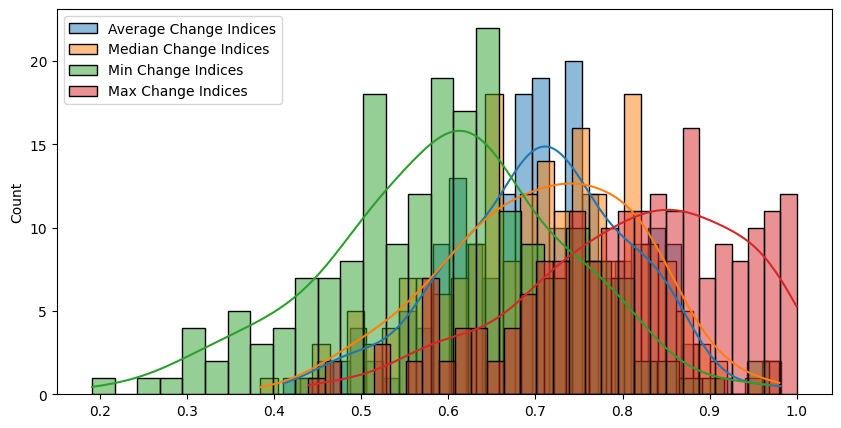

In [147]:
average_change_indices_norm = []
median_change_indices_norm = []
min_change_indices_norm = []
max_change_indices_norm = []
for abstract_index in result.keys():
    original_indices = result[abstract_index]["original"]["words_original_indices"]
    original_indices = [index for sublist in original_indices for index in sublist]
    altered_indices = result[abstract_index]["altered"]["words_altered_indices"]
    altered_indices = [index for sublist in altered_indices for index in sublist]

    original_length = result[abstract_index]["original"]["length"]
    altered_length = result[abstract_index]["altered"]["length"]

    print(f"\nabstract_index: {abstract_index}")
    print(f"original_length: {original_length} | original_indices: {original_indices} | normalized: {np.array(original_indices) / original_length}")
    print(f"altered_length: {altered_length} | altered_indices: {altered_indices} | normalized: {np.array(altered_indices) / altered_length}")

    average_change_indices_norm.append(
        np.mean(original_indices + altered_indices) / np.mean([original_length, altered_length])
    )
    median_change_indices_norm.append(
        np.median(original_indices + altered_indices) / np.mean([original_length, altered_length])
    )
    min_change_indices_norm.append(
        np.min(original_indices + altered_indices) / np.mean([original_length, altered_length])
    )
    max_change_indices_norm.append(
        np.max(original_indices + altered_indices) / np.mean([original_length, altered_length])
    )

fix, ax = plt.subplots(1, 1, figsize=(10, 5))
sns.histplot(average_change_indices_norm, bins=30, kde=True, ax=ax, label="Average Change Indices")
sns.histplot(median_change_indices_norm, bins=30, kde=True, ax=ax, label="Median Change Indices")
sns.histplot(min_change_indices_norm, bins=30, kde=True, ax=ax, label="Min Change Indices")
sns.histplot(max_change_indices_norm, bins=30, kde=True, ax=ax, label="Max Change Indices")
ax.legend()


* Correlate against ppl-diff of brainbench

In [171]:
x = np.array(average_change_indices_norm)
# x = np.array(median_change_indices_norm)
# x = np.array(min_change_indices_norm)
# x = np.array(max_change_indices_norm)

Slope: 1.0438305720062446, Intercept: -0.4654382785101853, R-squared: 0.005307464109204965, P-value: 0.3052722201767204
Slope: -0.9748808121632742, Intercept: 0.6271901866549394, R-squared: 0.004515627337380232, P-value: 0.34443347774473176


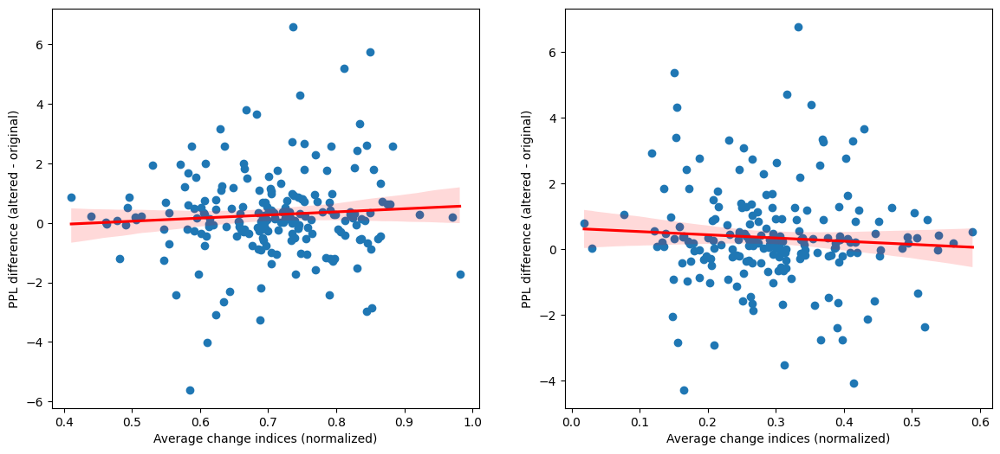

In [173]:
fig, axes = plt.subplots(1, 2, figsize=(14, 6))
axes[0].scatter(
    x,
    fwd_bayes_brainbench_ppls_diff,
)

# Fit a linear regression line
sns.regplot(
    x=x,
    y=fwd_bayes_brainbench_ppls_diff,
    ax=axes[0],
    scatter=False,
    color="red",
)

axes[0].set_xlabel("Average change indices (normalized)")
axes[0].set_ylabel("PPL difference (altered - original)")

# Plot slope significance
slope, intercept, r_value, p_value, std_err = stats.linregress(x, fwd_bayes_brainbench_ppls_diff)
print(f"Slope: {slope}, Intercept: {intercept}, R-squared: {r_value**2}, P-value: {p_value}")

axes[1].scatter(
    1-x,
    rev_bayes_brainbench_ppls_diff,
)

# Fit a linear regression line
sns.regplot(
    x=1-x,
    y=rev_bayes_brainbench_ppls_diff,
    ax=axes[1],
    scatter=False,
    color="red",
)

axes[1].set_xlabel("Average change indices (normalized)")
axes[1].set_ylabel("PPL difference (altered - original)")

# Plot slope significance
slope, intercept, r_value, p_value, std_err = stats.linregress(1-x, rev_bayes_brainbench_ppls_diff)
print(f"Slope: {slope}, Intercept: {intercept}, R-squared: {r_value**2}, P-value: {p_value}")

* Correlate againt brainbench correctness

In [174]:
fwd_bayes_brainbench_per_item_correctness = _per_item_correctness(fwd_bayes_brainbench_ppls, fwd_bayes_brainbench_labels)
rev_bayes_brainbench_per_item_correctness = _per_item_correctness(rev_bayes_brainbench_ppls, rev_bayes_brainbench_labels)
print(f"Fwd Bayes acc = {np.mean(fwd_bayes_brainbench_per_item_correctness)}")
print(f"Rev Bayes acc = {np.mean(rev_bayes_brainbench_per_item_correctness)}")

Fwd Bayes acc = 0.605
Rev Bayes acc = 0.64


Slope: 0.016732882292544448, Intercept: 0.5932329195503949, R-squared: 1.2673454984908363e-05, P-value: 0.9600982400103064
Slope: -0.23269856261325664, Intercept: 0.7090577349957878, R-squared: 0.0025422070066854208, P-value: 0.4783043239171709


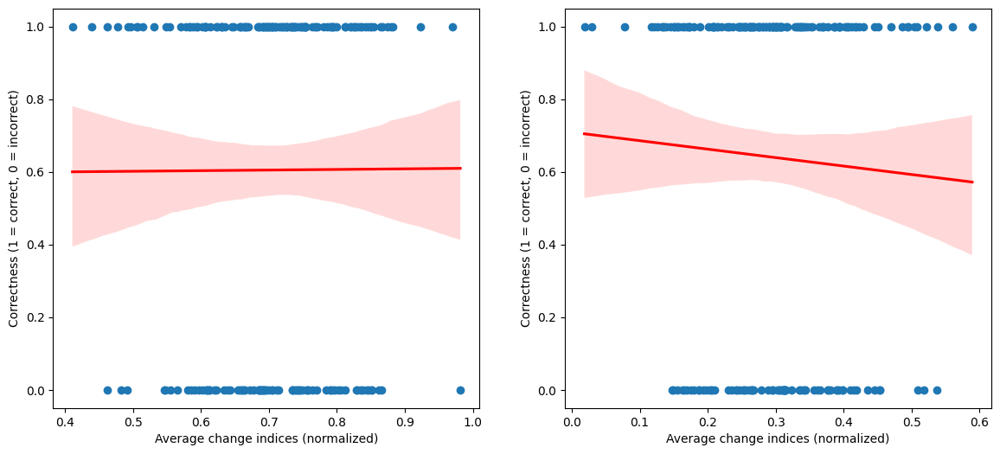

In [182]:
fig, axes = plt.subplots(1, 2, figsize=(14, 6))
axes[0].scatter(
    x,
    fwd_bayes_brainbench_per_item_correctness
)

# Fit a linear regression line
sns.regplot(
    x=x,
    y=fwd_bayes_brainbench_per_item_correctness,
    ax=axes[0],
    scatter=False,
    color="red",
)

axes[0].set_xlabel("Average change indices (normalized)")
axes[0].set_ylabel("Correctness (1 = correct, 0 = incorrect)")

# Plot slope significance
slope, intercept, r_value, p_value, std_err = stats.linregress(x, fwd_bayes_brainbench_per_item_correctness)
print(f"Slope: {slope}, Intercept: {intercept}, R-squared: {r_value**2}, P-value: {p_value}")

axes[1].scatter(
    1-x,
    rev_bayes_brainbench_per_item_correctness
)

# Fit a linear regression line
sns.regplot(
    x=1-x,
    y=rev_bayes_brainbench_per_item_correctness,
    ax=axes[1],
    scatter=False,
    color="red",
)

axes[1].set_xlabel("Average change indices (normalized)")
axes[1].set_ylabel("Correctness (1 = correct, 0 = incorrect)")

# Plot slope significance
slope, intercept, r_value, p_value, std_err = stats.linregress(1-x, rev_bayes_brainbench_per_item_correctness)
print(f"Slope: {slope}, Intercept: {intercept}, R-squared: {r_value**2}, P-value: {p_value}")

In [181]:
print(f"\nBayes Fwd model")
model = sm.Logit(fwd_bayes_brainbench_per_item_correctness, sm.add_constant(x))
result = model.fit()
print(result.summary())

print(f"\nBayes Rev model")
model = sm.Logit(rev_bayes_brainbench_per_item_correctness, sm.add_constant(1-x))
result = model.fit()
print(result.summary())


Bayes Fwd model
Optimization terminated successfully.
         Current function value: 0.670926
         Iterations 4
                           Logit Regression Results                           
Dep. Variable:                      y   No. Observations:                  200
Model:                          Logit   Df Residuals:                      198
Method:                           MLE   Df Model:                            1
Date:                Thu, 03 Apr 2025   Pseudo R-squ.:               9.444e-06
Time:                        16:13:54   Log-Likelihood:                -134.19
converged:                       True   LL-Null:                       -134.19
Covariance Type:            nonrobust   LLR p-value:                    0.9598
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.3771      0.988      0.382      0.703      -1.560       2.314
x1          

### Thinking (why no clear position effect?):
* Need to better deal with the large span of change positions (average is probably too coarse)
* We know intermediate accuracy is noisy (i.e., token-level correctness), so perhaps a more sensible way to find correlation is to do per position correctness (but more work and point is?)
* Can try to look at larger model (only fwd available) as they have higher acc.

### Try bigger fwd models

In [202]:
# model_name = "facebook/galactica-6.7b"
model_name = "mistralai/Mistral-7B-v0.1"

tokenizer = transformers.AutoTokenizer.from_pretrained(model_name)

fwd_brainbench_ppls_path = f"model_results/{model_name.replace('/', '--')}/human_abstracts/PPL_A_and_B.npy"
fwd_brainbench_labels_path = f"model_results/{model_name.replace('/', '--')}/human_abstracts/labels.npy"

fwd_brainbench_ppls = np.load(fwd_brainbench_ppls_path)
fwd_brainbench_labels = np.load(fwd_brainbench_labels_path)

fwd_brainbench_ppls_original, fwd_brainbench_ppls_altered, fwd_brainbench_ppls_diff \
    = _ppl_original_ppl_altered_and_ppl_diff(fwd_brainbench_ppls, fwd_brainbench_labels)

print(fwd_brainbench_ppls_original.shape, fwd_brainbench_ppls_diff.shape)


(200,) (200,)


In [205]:
tokenizer

LlamaTokenizerFast(name_or_path='mistralai/Mistral-7B-v0.1', vocab_size=32000, model_max_length=1000000000000000019884624838656, is_fast=True, padding_side='left', truncation_side='right', special_tokens={'bos_token': '<s>', 'eos_token': '</s>', 'unk_token': '<unk>'}, clean_up_tokenization_spaces=False, added_tokens_decoder={
	0: AddedToken("<unk>", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	1: AddedToken("<s>", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
	2: AddedToken("</s>", rstrip=False, lstrip=False, single_word=False, normalized=False, special=True),
}
)

In [206]:
brainbench_human_fpath = "testcases/BrainBench_Human_v0.1.csv"
brainbench_human_df = pd.read_csv(brainbench_human_fpath)
result = {}

for abstract_index, combined_abstract in enumerate(brainbench_human_df["combined_abstract"]):
    result[abstract_index] = {
        "original": {
            "words_original": [],
            "words_original_indices": [],
        },
        "altered": {
            "words_altered": [],
            "words_altered_indices": [],
        },
    }

    combined_abstract = prompt_template.replace("<choice abstract>", combined_abstract)
    print(f"Processing abstract index: {abstract_index}")
    result = get_all_changes_indices(abstract_index, combined_abstract, tokenizer)
    print("Done processing.")

Processing abstract index: 0

Matching iter 0
matches_original: [<re.Match object; span=(1221, 1245), match=' [[anterior, posterior]]'>]
matches_altered: [<re.Match object; span=(1221, 1245), match=' [[anterior, posterior]]'>]

match_idx: 0, match: [ [[anterior, posterior]]]
Processing replacement: x=[anterior] and y=[posterior] at char index original: [1221]
Processing replacement: x=[anterior] and y=[posterior] at char index altered: [1221]
tokens_before_original: ['▁You', '▁are', '▁a', '▁neuro', 'sc', 'ient', 'ist', '▁with', '▁deep', '▁knowledge', '▁in', '▁neuro', 'science', '.', '▁Here', '▁is', '▁an', '▁abstract', '▁from', '▁a', '▁neuro', 'science', '▁publication', ':', '▁To', '▁fluid', 'ly', '▁engage', '▁with', '▁the', '▁world', ',', '▁our', '▁brains', '▁must', '▁simultaneously', '▁represent', '▁both', '▁the', '▁scene', '▁in', '▁front', '▁of', '▁us', '▁and', '▁our', '▁memory', '▁of', '▁the', '▁immediate', '▁surrounding', '▁environment', '▁(', 'i', '.', 'e', '.,', '▁local', '▁vis',


abstract_index: 0
original_length: 388 | original_indices: [262, 286, 342, 378] | normalized: [0.67525773 0.7371134  0.8814433  0.9742268 ]
altered_length: 388 | altered_indices: [262, 286, 342, 378] | normalized: [0.67525773 0.7371134  0.8814433  0.9742268 ]

abstract_index: 1
original_length: 314 | original_indices: [166, 167, 199, 231, 232, 262] | normalized: [0.52866242 0.53184713 0.63375796 0.73566879 0.7388535  0.8343949 ]
altered_length: 314 | altered_indices: [166, 198, 199, 231, 261, 262] | normalized: [0.52866242 0.63057325 0.63375796 0.73566879 0.83121019 0.8343949 ]

abstract_index: 2
original_length: 261 | original_indices: [162, 191, 192, 193, 199, 238, 239, 240] | normalized: [0.62068966 0.73180077 0.73563218 0.7394636  0.76245211 0.91187739
 0.91570881 0.91954023]
altered_length: 261 | altered_indices: [162, 191, 192, 193, 199, 238, 239, 240] | normalized: [0.62068966 0.73180077 0.73563218 0.7394636  0.76245211 0.91187739
 0.91570881 0.91954023]

abstract_index: 3
orig

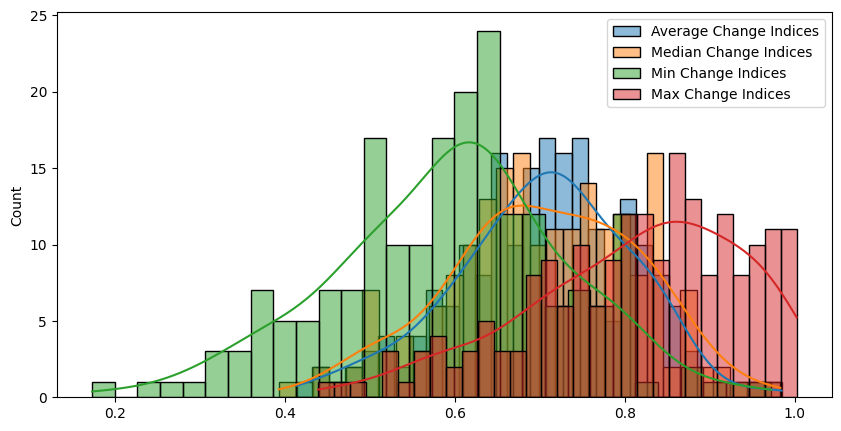

In [207]:
average_change_indices_norm = []
median_change_indices_norm = []
min_change_indices_norm = []
max_change_indices_norm = []
for abstract_index in result.keys():
    original_indices = result[abstract_index]["original"]["words_original_indices"]
    original_indices = [index for sublist in original_indices for index in sublist]
    altered_indices = result[abstract_index]["altered"]["words_altered_indices"]
    altered_indices = [index for sublist in altered_indices for index in sublist]

    original_length = result[abstract_index]["original"]["length"]
    altered_length = result[abstract_index]["altered"]["length"]

    print(f"\nabstract_index: {abstract_index}")
    print(f"original_length: {original_length} | original_indices: {original_indices} | normalized: {np.array(original_indices) / original_length}")
    print(f"altered_length: {altered_length} | altered_indices: {altered_indices} | normalized: {np.array(altered_indices) / altered_length}")

    average_change_indices_norm.append(
        np.mean(original_indices + altered_indices) / np.mean([original_length, altered_length])
    )
    median_change_indices_norm.append(
        np.median(original_indices + altered_indices) / np.mean([original_length, altered_length])
    )
    min_change_indices_norm.append(
        np.min(original_indices + altered_indices) / np.mean([original_length, altered_length])
    )
    max_change_indices_norm.append(
        np.max(original_indices + altered_indices) / np.mean([original_length, altered_length])
    )

fix, ax = plt.subplots(1, 1, figsize=(10, 5))
sns.histplot(average_change_indices_norm, bins=30, kde=True, ax=ax, label="Average Change Indices")
sns.histplot(median_change_indices_norm, bins=30, kde=True, ax=ax, label="Median Change Indices")
sns.histplot(min_change_indices_norm, bins=30, kde=True, ax=ax, label="Min Change Indices")
sns.histplot(max_change_indices_norm, bins=30, kde=True, ax=ax, label="Max Change Indices")
ax.legend()


Slope: 1.1692611319153619, Intercept: -0.5538704526110347, R-squared: 0.006523015341605941, P-value: 0.25558377066656723


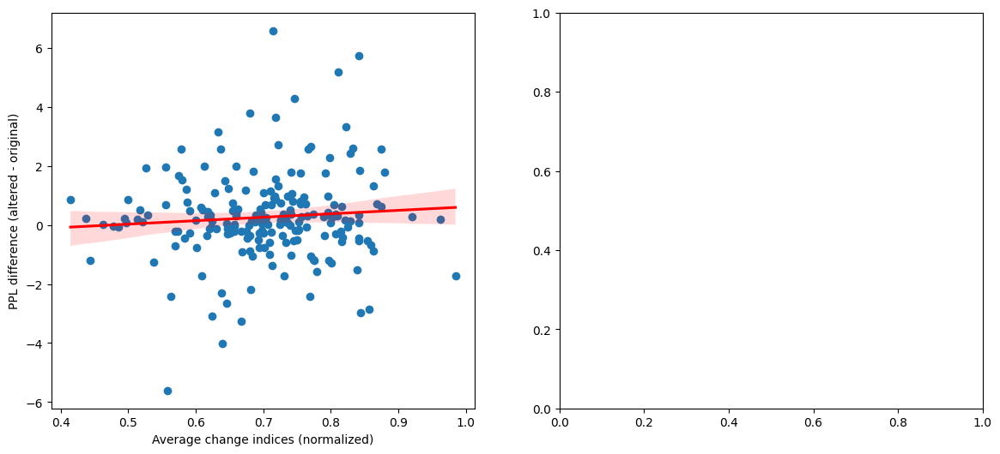

In [208]:
x = np.array(average_change_indices_norm)



fig, axes = plt.subplots(1, 2, figsize=(14, 6))
axes[0].scatter(
    x,
    fwd_bayes_brainbench_ppls_diff,
)

# Fit a linear regression line
sns.regplot(
    x=x,
    y=fwd_bayes_brainbench_ppls_diff,
    ax=axes[0],
    scatter=False,
    color="red",
)

axes[0].set_xlabel("Average change indices (normalized)")
axes[0].set_ylabel("PPL difference (altered - original)")

# Plot slope significance
slope, intercept, r_value, p_value, std_err = stats.linregress(x, fwd_bayes_brainbench_ppls_diff)
print(f"Slope: {slope}, Intercept: {intercept}, R-squared: {r_value**2}, P-value: {p_value}")

In [209]:
fwd_brainbench_per_item_correctness = _per_item_correctness(fwd_brainbench_ppls, fwd_brainbench_labels)
print(f"Fwd acc = {np.mean(fwd_brainbench_per_item_correctness)}")

Fwd acc = 0.83


Slope: 0.31605123950845687, Intercept: 0.6076820323281409, R-squared: 0.007500535987694258, P-value: 0.22269084781711987


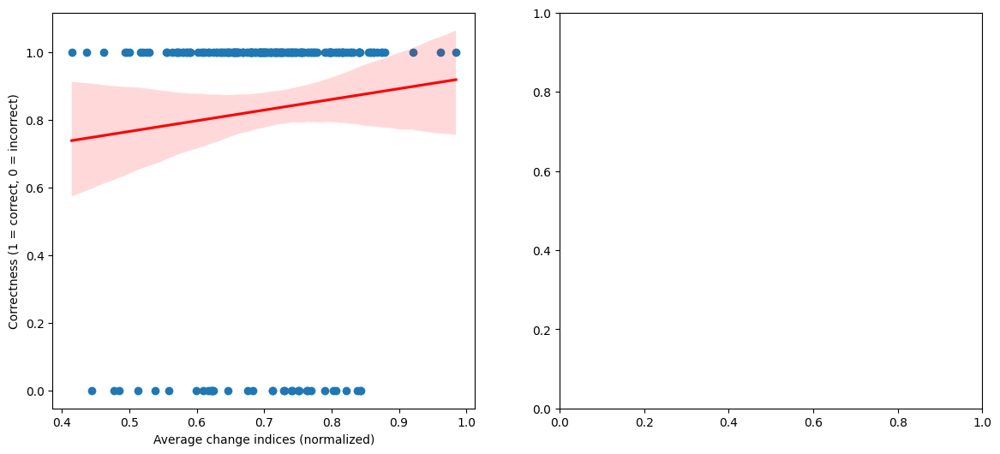

In [210]:
fig, axes = plt.subplots(1, 2, figsize=(14, 6))
axes[0].scatter(
    x,
    fwd_brainbench_per_item_correctness
)

# Fit a linear regression line
sns.regplot(
    x=x,
    y=fwd_brainbench_per_item_correctness,
    ax=axes[0],
    scatter=False,
    color="red",
)

axes[0].set_xlabel("Average change indices (normalized)")
axes[0].set_ylabel("Correctness (1 = correct, 0 = incorrect)")

# Plot slope significance
slope, intercept, r_value, p_value, std_err = stats.linregress(x, fwd_brainbench_per_item_correctness)
print(f"Slope: {slope}, Intercept: {intercept}, R-squared: {r_value**2}, P-value: {p_value}")

In [211]:
print(f"\nFwd bigger model")
model = sm.Logit(fwd_brainbench_per_item_correctness, sm.add_constant(x))
result = model.fit()
print(result.summary())


Fwd bigger model
Optimization terminated successfully.
         Current function value: 0.452172
         Iterations 6
                           Logit Regression Results                           
Dep. Variable:                      y   No. Observations:                  200
Model:                          Logit   Df Residuals:                      198
Method:                           MLE   Df Model:                            1
Date:                Thu, 03 Apr 2025   Pseudo R-squ.:                0.008147
Time:                        16:44:40   Log-Likelihood:                -90.434
converged:                       True   LL-Null:                       -91.177
Covariance Type:            nonrobust   LLR p-value:                    0.2229
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0466      1.262      0.037      0.971      -2.427       2.520
x1         